In [1]:
import numpy as np
from numpy import *
from qutip import *
from tqdm.auto import tqdm
import matplotlib.pyplot as plt
import math

In [2]:
from modules.spin_arch import *
from modules.su_algebra import *

In [3]:
from IPython.display import Latex

In [4]:
Ntrunc = 3 #global operator for truncation level or total number of dimensions

In [5]:
#initialize system
N = 3
Nlevel = Ntrunc
omega=51
Ej, Ec, g_arr, omega = generate_tmon_arch(N,Nlevel,o=omega)
sys1 = tmon_system(N, Nlevel, Ec, Ej, g_arr, omega)
chi=2*(60-omega)/(57-omega)

In [6]:
sys1.freq_list()

[[0.0, 60.0, 117.0], [0.0, 60.0, 117.0], [0.0, 60.0, 117.0]]

In [7]:
sys1.omega 

51

### Hamiltonian Evolution: $$e^{-iHt} \rho_0 e^{iHt}$$

In [23]:
a=1
b=1*np.sqrt(2)
c=1

# a=0.40824829
# b=0.70710678
# c=0.57735027
  

In [24]:
psi_2 = a*basis(Nlevel,0) + b*basis(Nlevel,1) + c*basis(Nlevel,2)
psi_2 = psi_2/psi_2.norm()
psi_2 = psi_2 * psi_2.dag()
psi0 = tensor([psi_2]*N) #sys1.tensor_projection_op(0,1,1, dim = None)

# psi0 = 1/sqrt(3)*(tensor([basis(Nlevel,0)]*N)+tensor([basis(Nlevel,1)]*N)+tensor([basis(Nlevel,2)]*N))
# psi0 =psi0*psi0.dag()

In [25]:
abs(trace((psi0.ptrace(0))**2))

1.0000000000000004

In [30]:
# Rotation to the state

psi0 = 1/sqrt(3)*(tensor([basis(Nlevel,0)]*N)+tensor([basis(Nlevel,1)]*N)+tensor([basis(Nlevel,2)]*N))
psi0 =psi0*psi0.dag()
L1,L2,L3,L4,L5,L6,L7,L8=(gen_basisoperators(N, Nlevel, spin = 1, op_type ="gellmann"))

meas=L3

print((meas.dag()*psi0*meas).tr())

# First Rotation

psi0=mesolve(L1,psi0,linspace(0,pi/8,100),[],[]).states[-1]

# Second Rotation

psi0=mesolve(L6,psi0,linspace(0,pi/8,100),[],[]).states[-1]


(meas.dag()*psi0*meas).tr()

6.000000000000002


3.7821663865662267

In [31]:
abs(trace((psi0.ptrace(0))**2))

0.33333333333333376

In [32]:
H = -sys1.H_I()
# psi0 = tensor([psi_2]*N) #sys1.tensor_projection_op(0,1,1, dim = None)
unit=abs((H/(2*pi))[1,3])
times = np.linspace(0,1/unit,201) #time scale is ~ 1/freq of self energy 
options = Options()
options.store_final_state = True
result = mesolve(H, psi0, times, [], options = options, progress_bar=True)
# print(len(result.states))

51 0.0 -0.3490658503988659
51 60.0 -1.0471975511965976
51 0.0 -0.3490658503988659
51 60.0 -1.0471975511965976
51 0.0 -0.3490658503988659
51 60.0 -1.0471975511965976
51 0.0 -0.3490658503988659
51 60.0 -1.0471975511965976
51 0.0 -0.3490658503988659
51 60.0 -1.0471975511965976
51 0.0 -0.3490658503988659
51 60.0 -1.0471975511965976
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.09s


In [33]:
# for i in range(len(times)):
purity = max([abs(trace((result.states[i].ptrace(0))**2)) for i in range(len(times))])
purity

0.5033987600684882

In [34]:
phase=0.25*pi

In [75]:
psi0 = 1/sqrt(3)*(tensor([basis(Nlevel,0)]*N)+tensor([basis(Nlevel,1)]*N)+exp(1j*phase)*tensor([basis(Nlevel,2)]*N))
psi0 =psi0*psi0.dag()

In [76]:
anglist=linspace(0,8,17)
print(anglist)
anglist=anglist*(2*pi)/8
anglist[0]+=0.0001

[0.  0.5 1.  1.5 2.  2.5 3.  3.5 4.  4.5 5.  5.5 6.  6.5 7.  7.5 8. ]


In [77]:
puritylist=[]
for theta1 in tqdm(anglist[0:5]):
    temp=[]
    for theta2 in anglist:

        # First Rotation
        psi1=mesolve(L1,psi0,linspace(0,theta1,5),[],[]).states[-1]
        # Second Rotation
        psi2=mesolve(L6,psi1,linspace(0,theta2,5),[],[]).states[-1]
        result = mesolve(H, psi2, times, [], options = options, progress_bar=True)
        purity = max([abs(trace((result.states[i].ptrace(0))**2)) for i in range(len(times))])
        temp.append(purity)
    puritylist.append(temp)

  0%|          | 0/5 [00:00<?, ?it/s]

10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Tota

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

In [80]:
max(max(puritylist))

0.8196053033891249

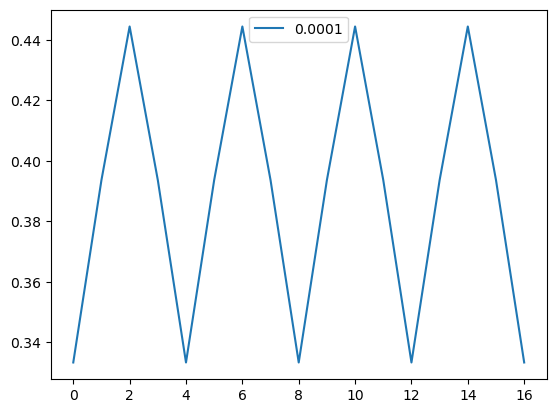

In [79]:
plt.plot(puritylist[4])
plt.legend([str(i) for i in anglist])

In [ ]:
mesolve(L1,psi0,linspace(0,pi,5),[],[]).states[-1]-mesolve(L1,psi0,linspace(0,pi,10),[],[]).states[-1]

# Code to iterate of the relative phase of 11 and 22

In [74]:
phase=0.25*pi

In [108]:
overall_purity=[]
phase=linspace(0,2*pi,20)
for i1 in tqdm(phase):
    for i2 in tqdm(phase):
        psi0 = 1/sqrt(3)*(tensor([basis(Nlevel,0)]*N)+exp(1j*i1)*tensor([basis(Nlevel,1)]*N)+exp(1j*i2)*tensor([basis(Nlevel,2)]*N))
        psi0 =psi0*psi0.dag()

        anglist=linspace(0,8,20)
        print(anglist)
        anglist=anglist*(2*pi)/8
        anglist[0]+=0.0001

        puritylist=[]
        for theta1 in (anglist[0:5]):
            temp=[]
            for theta2 in anglist:

                # First Rotation
                psi1=mesolve(L1,psi0,linspace(0,theta1,5),[],[]).states[-1]
                # Second Rotation
                psi2=mesolve(L6,psi1,linspace(0,theta2,5),[],[]).states[-1]
                result = mesolve(H, psi2, times, [], options = options, progress_bar=True)
                purity = max([abs(trace((result.states[i].ptrace(0))**2)) for i in range(len(times))])
                temp.append(purity)
            puritylist.append(temp)
        overall_purity.append(max(max(puritylist)))
        print(max(max(puritylist)))

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:0

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. tim

Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. tim

Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.55717517794627
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.5

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
0.6146024520538098
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est.

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

  0%|          | 0/20 [00:00<?, ?it/s]

[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:0

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.6197951617681334
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
0.5476645096199655
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est.

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

  0%|          | 0/20 [00:00<?, ?it/s]

[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:0

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.6826306721635433
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.5320784185673023
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est.

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

  0%|          | 0/20 [00:00<?, ?it/s]

[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:0

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.00s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.8495193194067837
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.811992032671792
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. 

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

  0%|          | 0/20 [00:00<?, ?it/s]

[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:0

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.02s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.854212034959587
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
0.8160672510957208
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est.

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

  0%|          | 0/20 [00:00<?, ?it/s]

[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:0

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.00s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.8358190122518554
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.7292470906598517
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est.

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

  0%|          | 0/20 [00:00<?, ?it/s]

[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:0

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.7684087645550433
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
0.7143272324760099
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est.

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

  0%|          | 0/20 [00:00<?, ?it/s]

[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:0

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.05s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.04s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.05s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.03s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.6743317830307893
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.6668496783449143
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est.

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

  0%|          | 0/20 [00:00<?, ?it/s]

[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:0

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.5958694100542535
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.6053570817538194
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est.

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

  0%|          | 0/20 [00:00<?, ?it/s]

[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:0

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.00s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
0.5553045862709411
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
0.558655001816575
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. 

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

  0%|          | 0/20 [00:00<?, ?it/s]

[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:0

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.03s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
0.5556389299697477
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
0.5550228562557684
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est.

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

  0%|          | 0/20 [00:00<?, ?it/s]

[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:0

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
0.6029935541660398
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.03s. Est. time left: 00:00:00:00
50.2%. Run time:   0.04s. Est. time left: 00:00:00:00
60.2%. Run time:   0.05s. Est. time left: 00:00:00:00
70.1%. Run time:   0.06s. Est. time left: 00:00:00:00
80.1%. Run time:   0.07s. Est. time left: 00:00:00:00
90.0%. Run time:   0.08s. Est. time left: 00:00:00:00
Total run time:   0.09s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.04s. Est. time left: 00:00:00:00
70.1%. Run time:   0.05s. Est. time left: 00:00:00:00
80.1%. Run time:   0.06s. Est. time left: 00:00:00:00
90.0%. Run time:   0.06s. Est. time left: 00:00:00:00
Total run time:   0.07s
10.4%. Run time:   0.02s. Est. tim

30.3%. Run time:   0.03s. Est. time left: 00:00:00:00
40.3%. Run time:   0.04s. Est. time left: 00:00:00:00
50.2%. Run time:   0.04s. Est. time left: 00:00:00:00
60.2%. Run time:   0.06s. Est. time left: 00:00:00:00
70.1%. Run time:   0.07s. Est. time left: 00:00:00:00
80.1%. Run time:   0.07s. Est. time left: 00:00:00:00
90.0%. Run time:   0.08s. Est. time left: 00:00:00:00
Total run time:   0.09s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.04s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.05s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.04s. Est. time left: 00:00:00:00
80.1%. Run time:   0.05s. Est. time left: 00:00:00:00
90.0%. Run time:   0.05s. Est. time left: 00:00:00:00
Total run time:   0.06s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.5932610832337231
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est.

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.07s. Est. time left: 00:00:00:00
Total run time:   0.07s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.05s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.05s. Est. time left: 00:00:00:00
Total run time:   0.06s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Tota

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.04s. Est. time left: 00:00:00:00
70.1%. Run time:   0.05s. Est. time left: 00:00:00:00
80.1%. Run time:   0.05s. Est. time left: 00:00:00:00
90.0%. Run time:   0.06s. Est. time left: 00:00:00:00
Total run time:   0.07s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.05s. Est. time left: 00:00:00:00
Total run time:   0.06s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.04s. Est. time left: 00:00:00:00
70.1%. Run time:   0.04s. Est. time left: 00:00:00:00
80.1%. Run time:   0.05s. Est. tim

Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

  0%|          | 0/20 [00:00<?, ?it/s]

[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:0

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.05s. Est. time left: 00:00:00:00
Total run time:   0.06s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.04s. Est. time left: 00:00:00:00
70.1%. Run time:   0.05s. Est. time left: 00:00:00:00
80.1%. Run time:   0.06s. Est. time left: 00:00:00:00
90.0%. Run time:   0.06s. Est. time left: 00:00:00:00
Total run time:   0.07s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.04s. Est. time left: 00:00:00:00
70.1%. Run time:   0.04s. Est. time left: 00:00:00:00
80.1%. Run time:   0.05s. Est. time left: 00:00:00:00
90.0%. Run time:   0.06s. Est. time left: 00:00:00:00
Total run time:   0.07s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.04s. Est. time left: 00:00:00:00
70.1%. Run time:   0.05s. Est. time left: 00:00:00:00
80.1%. Run time:   0.06s. Est. time left: 00:00:00:00
90.0%. Run time:   0.06s. Est. time left: 00:00:00:00
Total run time:   0.07s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.03s. Est. time left: 00:00:00:00
50.2%. Run time:   0.04s. Est. time left: 00:00:00:00
60.2%. Run time:   0.04s. Est. time left: 00:00:00:00
70.1%. Run time:   0.05s. Est. time left: 00:00:00:00
80.1%. Run time:   0.06s. Est. time left: 00:00:00:00
90.0%. Run time:   0.07s. Est. time left: 00:00:00:00
Total run time:   0.08s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. tim

90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.04s. Est. time left: 00:00:00:00
80.1%. Run time:   0.05s. Est. time left: 00:00:00:00
90.0%. Run time:   0.05s. Est. time left: 00:00:00:00
Total run time:   0.06s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.04s. Est. time left: 00:00:00:00
60.2%. Run time:   0.05s. Est. time left: 00:00:00:00
70.1%. Run time:   0.06s. Est. time left: 00:00:00:00
80.1%. Run time:   0.07s. Est. time left: 00:00:00:00
90.0%. Run time:   0.08s. Est. time left: 00:00:00:00
Total run time:   0.09s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.04s. Est. time left: 00:00:00:00
70.1%. Run time:   0.04s. Est. time left: 00:00:00:00
80.1%. Run time:   0.05s. Est. time left: 00:00:00:00
90.0%. Run time:   0.05s. Est. time left: 00:00:00:00
Total run time:   0.06s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.05s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.04s. Est. time left: 00:00:00:00
70.1%. Run time:   0.05s. Est. time left: 00:00:00:00
80.1%. Run time:   0.05s. Est. time left: 00:00:00:00
90.0%. Run time:   0.06s. Est. time left: 00:00:00:00
Total run time:   0.07s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.6830433114421841
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2

90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.04s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.05s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
0.6751652401287587
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est.

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.05s. Est. time left: 00:00:00:00
Total run time:   0.06s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.04s. Est. time left: 00:00:00:00
70.1%. Run time:   0.04s. Est. time left: 00:00:00:00
80.1%. Run time:   0.05s. Est. time left: 00:00:00:00
90.0%. Run time:   0.05s. Est. time left: 00:00:00:00
Total run time:   0.06s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.05s. Est. time left: 00:00:00:00
Total run time:   0.06s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.03s. Est. time left: 00:00:00:00
50.2%. Run time:   0.04s. Est. time left: 00:00:00:00
60.2%. Run time:   0.04s. Est. time left: 00:00:00:00
70.1%. Run time:   0.05s. Est. time left: 00:00:00:00
80.1%. Run time:   0.07s. Est. time left: 00:00:00:00
90.0%. Run time:   0.07s. Est. time left: 00:00:00:00
Total run time:   0.08s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

  0%|          | 0/20 [00:00<?, ?it/s]

[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:0

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.04s. Est. time left: 00:00:00:00
70.1%. Run time:   0.04s. Est. time left: 00:00:00:00
80.1%. Run time:   0.05s. Est. time left: 00:00:00:00
90.0%. Run time:   0.06s. Est. time left: 00:00:00:00
Total run time:   0.06s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.03s. Est. time left: 00:00:00:00
30.3%. Run time:   0.04s. Est. time left: 00:00:00:00
40.3%. Run time:   0.04s. Est. time left: 00:00:00:00
50.2%. Run time:   0.04s. Est. time left: 00:00:00:00
60.2%. Run time:   0.05s. Est. time left: 00:00:00:00
70.1%. Run time:   0.05s. Est. time left: 00:00:00:00
80.1%. Run time:   0.05s. Est. time left: 00:00:00:00
90.0%. Run time:   0.06s. Est. time left: 00:00:00:00
Total run time:   0.06s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.05s. Est. time left: 00:00:00:00
90.0%. Run time:   0.06s. Est. time left: 00:00:00:00
Total run time:   0.07s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.04s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.05s. Est. time left: 00:00:00:00
Total run time:   0.06s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.04s. Est. time left: 00:00:00:00
80.1%. Run time:   0.05s. Est. time left: 00:00:00:00
90.0%. Run time:   0.05s. Est. time left: 00:00:00:00
Total run time:   0.06s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.03s. Est. time left: 00:00:00:00
50.2%. Run time:   0.04s. Est. time left: 00:00:00:00
60.2%. Run time:   0.05s. Est. time left: 00:00:00:00
70.1%. Run time:   0.06s. Est. time left: 00:00:00:00
80.1%. Run time:   0.06s. Est. time left: 00:00:00:00
90.0%. Run time:   0.07s. Est. time left: 00:00:00:00
Total run time:   0.08s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. tim

90.0%. Run time:   0.06s. Est. time left: 00:00:00:00
Total run time:   0.06s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.04s. Est. time left: 00:00:00:00
70.1%. Run time:   0.05s. Est. time left: 00:00:00:00
80.1%. Run time:   0.05s. Est. time left: 00:00:00:00
90.0%. Run time:   0.06s. Est. time left: 00:00:00:00
Total run time:   0.07s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.07s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
0.7502843842626966
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.05s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.04s. Est. time left: 00:00:00:00
70.1%. Run time:   0.04s. Est. time left: 00:00:00:00
80.1%. Run time:   0.05s. Est. time left: 00:00:00:00
90.0%. Run time:   0.05s. Est. time left: 00:00:00:00
Total run time:   0.06s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.03s. Est. time left: 00:00:00:00
40.3%. Run time:   0.03s. Est. time left: 00:00:00:00
50.2%. Run time:   0.04s. Est. time left: 00:00:00:00
60.2%. Run time:   0.04s. Est. time left: 00:00:00:00
70.1%. Run time:   0.05s. Est. time left: 00:00:00:00
80.1%. Run time:   0.06s. Est. time left: 00:00:00:00
90.0%. Run time:   0.06s. Est. time left: 00:00:00:00
Total run time:   0.07s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.03s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.04s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.05s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.7677285973862802
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est.

80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. tim

Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.04s. Est. time left: 00:00:00:00
80.1%. Run time:   0.05s. Est. time left: 00:00:00:00
90.0%. Run time:   0.05s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. tim

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.04s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.05s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.01s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.04s. Est. time left: 00:00:00:00
70.1%. Run time:   0.05s. Est. time left: 00:00:00:00
80.1%. Run time:   0.05s. Est. time left: 00:00:00:00
90.0%. Run time:   0.06s. Est. time left: 00:00:00:00
Total run time:   0.06s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.05s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.03s
0.7331906086849448
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%.

70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.04s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.04s. Est. time left: 00:00:00:00
70.1%. Run time:   0.04s. Est. time left: 00:00:00:00
80.1%. Run time:   0.05s. Est. time left: 00:00:00:00
90.0%. Run time:   0.05s. Est. tim

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.04s. Est. time left: 00:00:00:00
70.1%. Run time:   0.04s. Est. time left: 00:00:00:00
80.1%. Run time:   0.05s. Est. time left: 00:00:00:00
90.0%. Run time:   0.06s. Est. time left: 00:00:00:00
Total run time:   0.06s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.01s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

  0%|          | 0/20 [00:00<?, ?it/s]

[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.04s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.05s. Est. time left: 00:00:00:00
Total run time:   0.06s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:0

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.06s. Est. time left: 00:00:00:00
80.1%. Run time:   0.07s. Est. time left: 00:00:00:00
90.0%. Run time:   0.08s. Est. time left: 00:00:00:00
Total run time:   0.08s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.04s. Est. time left: 00:00:00:00
70.1%. Run time:   0.05s. Est. time left: 00:00:00:00
80.1%. Run time:   0.06s. Est. time left: 00:00:00:00
90.0%. Run time:   0.07s. Est. time left: 00:00:00:00
Total run time:   0.08s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.04s. Est. time left: 00:00:00:00
80.1%. Run time:   0.05s. Est. time left: 00:00:00:00
90.0%. Run time:   0.06s. Est. time left: 00:00:00:00
Total run time:   0.07s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.04s. Est. time left: 00:00:00:00
70.1%. Run time:   0.04s. Est. time left: 00:00:00:00
80.1%. Run time:   0.05s. Est. time left: 00:00:00:00
90.0%. Run time:   0.05s. Est. time left: 00:00:00:00
Total run time:   0.06s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.03s. Est. time left: 00:00:00:00
50.2%. Run time:   0.04s. Est. time left: 00:00:00:00
60.2%. Run time:   0.04s. Est. time left: 00:00:00:00
70.1%. Run time:   0.05s. Est. time left: 00:00:00:00
80.1%. Run time:   0.05s. Est. time left: 00:00:00:00
90.0%. Run time:   0.06s. Est. time left: 00:00:00:00
Total run time:   0.07s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.04s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.05s. Est. time left: 00:00:00:00
Total run time:   0.06s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.03s. Est. time left: 00:00:00:00
50.2%. Run time:   0.04s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.03s. Est. time left: 00:00:00:00
60.2%. Run time:   0.04s. Est. time left: 00:00:00:00
70.1%. Run time:   0.04s. Est. time left: 00:00:00:00
80.1%. Run time:   0.05s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
0.7786412541216261
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.04s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.05s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.8355676268956548
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est.

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.04s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.03s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

  0%|          | 0/20 [00:00<?, ?it/s]

[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:0

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. tim

Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. tim

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. tim

90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
0.8410421920417339
[0.         0.4

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.8539894964469315
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est.

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

  0%|          | 0/20 [00:00<?, ?it/s]

[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:0

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.835648530988928
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
0.8492573898810931
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est.

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

  0%|          | 0/20 [00:00<?, ?it/s]

[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:0

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.02s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.5320784165320852
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.7356317003186712
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est.

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

  0%|          | 0/20 [00:00<?, ?it/s]

[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:0

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.5398406719788708
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.6858128550407265
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est.

90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.04s. Est. time left: 00:00:00:00
Total run time:   0.04s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

  0%|          | 0/20 [00:00<?, ?it/s]

[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:0

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.03s. Est. time left: 00:00:00:00
80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.55717517794627
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.5

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.03s. Est. time left: 00:00:00:00
20.4%. Run time:   0.05s. Est. time left: 00:00:00:00
30.3%. Run time:   0.05s. Est. time left: 00:00:00:00
40.3%. Run time:   0.05s. Est. time left: 00:00:00:00
50.2%. Run time:   0.05s. Est. time left: 00:00:00:00
60.2%. Run time:   0.06s. Est. time left: 00:00:00:00
70.1%. Run time:   0.06s. Est. time left: 00:00:00:00
80.1%. Run time:   0.06s. Est. time left: 00:00:00:00
90.0%. Run time:   0.06s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.01s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
0.6146024520538098
[0.         0.42105263 0.84210526 1.26315789 1.68421053 2.10526316
 2.52631579 2.94736842 3.36842105 3.78947368 4.21052632 4.63157895
 5.05263158 5.47368421 5.89473684 6.31578947 6.73684211 7.15789474
 7.57894737 8.        ]
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est.

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. tim

Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.05s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. tim

60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. tim

80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. tim

80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.02s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. time left: 00:00:00:00
30.3%. Run time:   0.02s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.02s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.00s. Est. time left: 00:00:00:00
60.2%. Run time:   0.00s. Est. time left: 00:00:00:00
70.1%. Run time:   0.00s. Est. time left: 00:00:00:00
80.1%. Run time:   0.00s. Est. time left: 00:00:00:00
90.0%. Run time:   0.00s. Est. time left: 00:00:00:00
Total run time:   0.00s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.02s. Est. tim

In [75]:
psi0 = 1/sqrt(3)*(tensor([basis(Nlevel,0)]*N)+tensor([basis(Nlevel,1)]*N)+exp(1j*phase)*tensor([basis(Nlevel,2)]*N))
psi0 =psi0*psi0.dag()

In [110]:
max(overall_purity)

0.8543023787869297

# Continuous angle iteration

## Keeping One angle constant

In [89]:
phase2=0*pi
phase1=0*pi

psi0 = 1/sqrt(3)*(tensor([basis(Nlevel,0)]*N)+exp(1j*phase1)*tensor([basis(Nlevel,1)]*N)+exp(1j*phase2)*tensor([basis(Nlevel,2)]*N))
psi0 =psi0*psi0.dag()

In [101]:
anglist=linspace(0,1,41)
print(anglist)
anglist=anglist*pi/4
anglist[0]+=0.0001

[0.    0.025 0.05  0.075 0.1   0.125 0.15  0.175 0.2   0.225 0.25  0.275
 0.3   0.325 0.35  0.375 0.4   0.425 0.45  0.475 0.5   0.525 0.55  0.575
 0.6   0.625 0.65  0.675 0.7   0.725 0.75  0.775 0.8   0.825 0.85  0.875
 0.9   0.925 0.95  0.975 1.   ]


In [103]:
puritylist=[]


for theta1 in tqdm(anglist):
    temp=[]
    for theta2 in anglist:

        # First Rotation
        psi1=mesolve(L1,psi0,linspace(0,theta1,5),[],[]).states[-1]
        # Second Rotation
        psi2=mesolve(L6,psi1,linspace(0,theta2,5),[],[]).states[-1]
        result = mesolve(H, psi2, times, [], options = options, progress_bar=True)
        purity = max([abs(trace((result.states[i].ptrace(0))**2)) for i in range(len(times))])
        temp.append(purity)
    puritylist.append(temp)

  0%|          | 0/41 [00:00<?, ?it/s]

10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.02s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Tota

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.03s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.01s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.03s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.02s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.03s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. tim

70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.00s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.01s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. tim

80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. tim

90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. tim

Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. tim

20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. tim

30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.02s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.01s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. tim

40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. tim

50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.01s. Est. time left: 00:00:00:00
90.0%. Run time:   0.01s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. time left: 00:00:00:00
50.2%. Run time:   0.01s. Est. time left: 00:00:00:00
60.2%. Run time:   0.01s. Est. time left: 00:00:00:00
70.1%. Run time:   0.01s. Est. time left: 00:00:00:00
80.1%. Run time:   0.02s. Est. time left: 00:00:00:00
90.0%. Run time:   0.02s. Est. time left: 00:00:00:00
Total run time:   0.02s
10.4%. Run time:   0.00s. Est. time left: 00:00:00:00
20.4%. Run time:   0.00s. Est. time left: 00:00:00:00
30.3%. Run time:   0.00s. Est. time left: 00:00:00:00
40.3%. Run time:   0.01s. Est. tim

In [104]:
max(max(puritylist))

0.8568013655294601

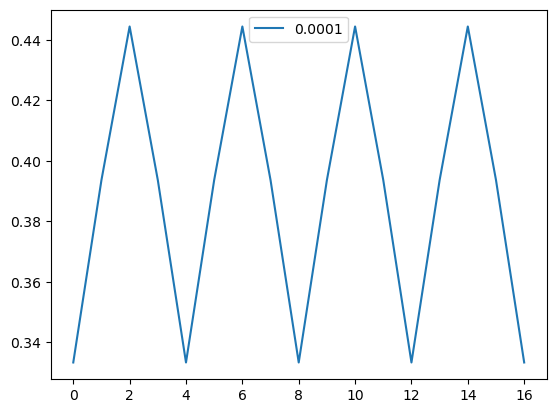

In [79]:
plt.plot(puritylist[0])
plt.legend([str(i) for i in anglist])